<a href="https://colab.research.google.com/github/abahmer/Simulation_spring/blob/main/Simulation_Spring_network.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#@title Nearly original code
#https://philip-mocz.medium.com/
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib import animation, rc
rc('animation', html='html5')
# convert subindex (i,j) to linear index (idx)
def sub2ind(array_shape, i, j):
    idx = i*array_shape[1] + j
    return idx
# calculate acceleration on nodes using hooke's law + gravity
def getAcc(pos, ci, cj, springL, spring_coeff, gravity):
	acc = np.zeros(pos.shape)
	# Hooke's law: F = - k * displacement along spring
	sep_vec = pos[ci,:] - pos[cj,:]
	sep = np.linalg.norm( sep_vec, axis = 1)
	dL = sep - springL
	ax = - spring_coeff * dL * sep_vec[:,0] / sep  
	ay = - spring_coeff * dL * sep_vec[:,1] / sep
	np.add.at(acc[:,0], ci, ax)
	np.add.at(acc[:,1], ci, ay)
	np.add.at(acc[:,0], cj, -ax)
	np.add.at(acc[:,1], cj, -ay)
	acc[:,1] += gravity
	return acc
# apply box boundary conditions, reverse velocity if outside box
def applyBoundary(pos, vel, boxsize):
	for d in range(0,2):
		is_out = np.where(pos[:,d] < 0)
		pos[is_out, d] *= -1 
		vel[is_out, d] *= -1 
		is_out = np.where(pos[:,d] > boxsize)
		pos[is_out, d] *= -1 
		vel[is_out, d] *= -1 
	return (pos, vel)
N         = 4      # Number of nodes per linear dimension
t         = 0      # current time of the simulation
dt        = 0.1    # timestep default 0.1
Nt        = 400   # number of timesteps default 400
spring_coeff = 40  # Hooke's law spring coefficient
gravity   = -0.1   # strength of gravity
# construct spring nodes / initial conditions
boxsize = 3
xlin = np.linspace(1,2,N)
x, y = np.meshgrid(xlin, xlin)
x = x.flatten()
y = y.flatten()
pos = np.vstack((x,y)).T
vel = np.zeros(pos.shape)
acc = np.zeros(pos.shape)
np.random.seed(17)            # set the random number generator seed
vel += 0.01*np.random.randn(N**2,2)
# construct spring network connections
ci = []
cj = []
#  o--o
for r in range(0,N): #row
	for c in range(0,N-1): #colomn
		idx_i = sub2ind([N, N], r, c)
		idx_j = sub2ind([N, N], r, c+1)
		ci.append(idx_i)
		cj.append(idx_j)
# o
# |
# o
for r in range(0,N-1): 
	for c in range(0,N):
		idx_i = sub2ind([N, N], r, c)
		idx_j = sub2ind([N, N], r+1, c)
		ci.append(idx_i)
		cj.append(idx_j)	
 # o
#   \
#     o
for r in range(0,N-1):
	for c in range(0,N-1):
		idx_i = sub2ind([N, N], r, c)
		idx_j = sub2ind([N, N], r+1, c+1)
		ci.append(idx_i)
		cj.append(idx_j)	
 #     o
#   /
# o
for r in range(0,N-1):
	for c in range(0,N-1):
		idx_i = sub2ind([N, N], r+1, c)
		idx_j = sub2ind([N, N], r, c+1)
		ci.append(idx_i)
		cj.append(idx_j)
springL = np.linalg.norm( pos[ci,:] - pos[cj,:], axis = 1)

fig = plt.figure(figsize=(10, 10))
plt.close(fig)
ax = fig.add_subplot(xlim=(0, boxsize), ylim=(0,boxsize))

def animate(i,vel,pos,acc,t):	
  ax.cla()
  ax.set(xlim=(0, boxsize), ylim=(0, boxsize))
  vel += acc * dt/2 # (1/2) kick
  pos += vel * dt # drift
  pos, vel = applyBoundary(pos, vel, boxsize)
  acc = getAcc( pos, ci, cj, springL, spring_coeff, gravity )	# update accelerations
  vel += acc * dt/2	# (1/2) kick
  t += dt
  scat=ax.scatter(pos[[ci, cj],0],pos[[ci, cj],1],s=10,color='blue')
  ax.plot(pos[[ci, cj],0],pos[[ci, cj],1],color='b')
  return scat,

ani = animation.FuncAnimation(fig, animate, Nt, fargs=(vel,pos,acc,t),interval=50, blit=True)
HTML(ani.to_jshtml())

In [ ]:
#@title Stabilitätstest dt explosion bei dt=0.2 leapfrog stability
#TODO runge kutta
#https://philip-mocz.medium.com/
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib import animation, rc
rc('animation', html='html5')
# convert subindex (i,j) to linear index (idx)
def sub2ind(array_shape, i, j):
    idx = i*array_shape[1] + j
    return idx
# calculate acceleration on nodes using hooke's law + gravity
def getAcc(pos, ci, cj, springL, spring_coeff, gravity):
	acc = np.zeros(pos.shape)
	# Hooke's law: F = - k * displacement along spring
	sep_vec = pos[ci,:] - pos[cj,:]
	sep = np.linalg.norm( sep_vec, axis = 1)
	dL = sep - springL
	ax = - spring_coeff * dL * sep_vec[:,0] / sep  
	ay = - spring_coeff * dL * sep_vec[:,1] / sep
	np.add.at(acc[:,0], ci, ax)
	np.add.at(acc[:,1], ci, ay)
	np.add.at(acc[:,0], cj, -ax)
	np.add.at(acc[:,1], cj, -ay)
	acc[:,1] += gravity
	return acc
# apply box boundary conditions, reverse velocity if outside box
def applyBoundary(pos, vel, boxsize):
	for d in range(0,2):
		is_out = np.where(pos[:,d] < 0)
		pos[is_out, d] *= -1 
		vel[is_out, d] *= -1 
		is_out = np.where(pos[:,d] > boxsize)
		pos[is_out, d] *= -1 
		vel[is_out, d] *= -1 
	return (pos, vel)
N         = 3      # Number of nodes per linear dimension
t         = 0      # current time of the simulation
dt        = 0.16    # timestep 0.17 not stable at N=3
Nt        = 1000   # number of timesteps default 400
spring_coeff = 40  # Hooke's law spring coefficient
gravity   = -0.1   # strength of gravity
# construct spring nodes / initial conditions
boxsize = 3
xlin = np.linspace(1,2,N)
x, y = np.meshgrid(xlin, xlin)
x = x.flatten()
y = y.flatten()
pos = np.vstack((x,y)).T
vel = np.zeros(pos.shape)
acc = np.zeros(pos.shape)
np.random.seed(17)            # set the random number generator seed
vel += 0.01*np.random.randn(N**2,2)
ci = []
cj = []
for r in range(0,N): #row
	for c in range(0,N-1): #colomn
		idx_i = sub2ind([N, N], r, c)
		idx_j = sub2ind([N, N], r, c+1)
		ci.append(idx_i)
		cj.append(idx_j)
for r in range(0,N-1): 
	for c in range(0,N):
		idx_i = sub2ind([N, N], r, c)
		idx_j = sub2ind([N, N], r+1, c)
		ci.append(idx_i)
		cj.append(idx_j)	
for r in range(0,N-1):
	for c in range(0,N-1):
		idx_i = sub2ind([N, N], r, c)
		idx_j = sub2ind([N, N], r+1, c+1)
		ci.append(idx_i)
		cj.append(idx_j)	
for r in range(0,N-1):
	for c in range(0,N-1):
		idx_i = sub2ind([N, N], r+1, c)
		idx_j = sub2ind([N, N], r, c+1)
		ci.append(idx_i)
		cj.append(idx_j)
springL = np.linalg.norm( pos[ci,:] - pos[cj,:], axis = 1)
fig = plt.figure(figsize=(10, 10))
plt.close(fig)
ax = fig.add_subplot(xlim=(0, boxsize), ylim=(0,boxsize))
def animate(i,vel,pos,acc,t):	
  ax.cla()
  ax.set(xlim=(0, boxsize), ylim=(0, boxsize))
  vel += acc * dt/2 # (1/2) kick
  pos += vel * dt # drift
  pos, vel = applyBoundary(pos, vel, boxsize)
  acc = getAcc( pos, ci, cj, springL, spring_coeff, gravity )	# update accelerations
  vel += acc * dt/2	# (1/2) kick
  t += dt
  scat=ax.scatter(pos[[ci, cj],0],pos[[ci, cj],1],s=10,color='blue')
  ax.plot(pos[[ci, cj],0],pos[[ci, cj],1],color='b')
  return scat,
ani = animation.FuncAnimation(fig, animate, Nt, fargs=(vel,pos,acc,t),interval=50, blit=True)
HTML(ani.to_jshtml())

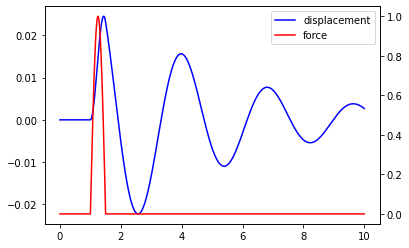

In [ ]:
# @title 1D spring with runge kutta
#TODO: here one spring in 1D, change in 2d und mit spring length
def runga_kutta_vibrations(t, u0, v0, m, c, k, force):  #change to one step
    """
    :param m:(flt) Mass.
    :param c: (flt) Damping.
    :param k: (flt) Spring stiffness.
    :param force: (list/ array) Force acting on the system.
    :return: (tpl) (displacement u, velocity v)
    """
    u = np.zeros(t.shape)
    v = np.zeros(t.shape)
    u[0] = u0 #:param u0: (flt)u at t[0]
    v[0] = v0 #:param v0: (flt) v at t[0].
    dt = t[1] - t[0]
    # Returns the acceleration a
    def func(u, V, force):
        return (force - c * V - k * u) / m
  #here time step after time step i+1 translate to i
    for i in range(t.size - 1):
        # F at time step t / 2
        f_t_05 = (force[i + 1] - force[i]) / 2 + force[i]
        u1 = u[i]
        v1 = v[i]
        a1 = func(u1, v1, force[i])
        u2 = u[i] + v1 * dt / 2
        v2 = v[i] + a1 * dt / 2
        a2 = func(u2, v2, f_t_05)
        u3 = u[i] + v2 * dt / 2
        v3 = v[i] + a2 * dt / 2
        a3 = func(u3, v3, f_t_05)
        u4 = u[i] + v3 * dt
        v4 = v[i] + a3 * dt
        a4 = func(u4, v4, force[i + 1])
        u[i + 1] = u[i] + dt / 6 * (v1 + 2 * v2 + 2 * v3 + v4)
        v[i + 1] = v[i] + dt / 6 * (a1 + 2 * a2 + 2 * a3 + a4)
    return u, v

n = 1000
t = np.linspace(0, 10, n)
force = np.zeros(n)
for i in range(100, 150):
    a = np.pi / 50 * (i - 100)
    force[i] = np.sin(a)

# Parameters of the mass spring system
m = 10
k = 50
c = 5
u, v = runga_kutta_vibrations(t, 0, 0, m, c, k, force)

# Plot the result
fig, ax1 = plt.subplots()
l1 = ax1.plot(t, v, color='b', label="displacement")
ax2 = ax1.twinx()
l2 = ax2.plot(t, force, color='r', label="force")
lines = l1 + l2
plt.legend(lines, [l.get_label() for l in lines])
plt.show()
